# Shallow Water Equations in 1D with Python and Numpy

The one-dimensional (non-rotating small-amplitude gravity wave on a resting basic state, without topography) Shallow Water equations have the form

$$\frac{\partial H}{\partial t} + \hat{H} \frac{\partial (U)}{\partial x} = 0$$

$$\frac{\partial (U)}{\partial t} + g \frac{\partial ( H )}{\partial x} = 0$$

Where $U$ is the velocity, $H$ is the height of the water column and $g$ is the gravitational acceleration.

We will discretize using the FTCS scheme:

$$H^{n+1}_i = H^{n}_i - \hat{H} \frac{\Delta t}{2\Delta x} \left( U^{n}_{i+1} - U^{n}_{i-1}\right)$$

$$U^{n+1}_i = U^{n}_{i} - g \frac{\Delta t}{2\Delta x} \left(H^{n}_{i+1} - H^{n}_{i-1}\right)$$

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
from JSAnimation.IPython_display import display_animation
import SWE_base_parameters
import shallowwater_base
#CPL the Python explicit way, which is more general and also similar to FORTRAN, C++ etc.
#from shallowwater_base import d_dx_1D_CS_explicit as d_dx
#CPL less general, makes use of specific Python syntax, somewhat less readable
from shallowwater_base import d_dx_1D_CS_python_specific as d_dx
#CPL CAREFUL!!!!
#the one below uses roll, which is attractive from the point of view of vector computing, albeit only 100% suitable for periodic BCs
#from shallowwater_base import d_dx_1D_CS as d_dx
from shallowwater_base import initialise, boundary_conditions
%matplotlib inline

The following function will solve the equations as we've discretized above.  There are two different initial conditions set up here.  The first is an exponential which simulates the after effect of a drop of water hitting a calm surface. The second is a "dam" problem, which simulates a wall of water being suddenly released. 

Note that the function to perform the spatial derivative in the x direction is imported as d_dx, but its definition comes from all the variants of "d_dx_1D_CS" in the library.

The boundary conditions applied here are those of "reflective"  Any fluid which reaches the edge of the simulation area will simply bounce back.

In [2]:
def python_1d_shallow(nt, nx, HT, H, U, g, xlen, BC):
    for timestep in range(nt):
        H = H - Hhat*dt*d_dx(U)
        U = U -    g*dt*d_dx(H)
        H,U=boundary_conditions(H,U,BC)
        Ht[:,timestep]=H[:]    
    return Ht

##Visualizing results with the "droplet" initial condition
Let's take a look at a JSanimation of our results for the dam break initial conditions.  We'll set up our problem as follows:

*  $nx = 101$
*  $g = 1$
*  $xlen = 4$

Let's take a look at a JSanimation of our results for the droplet initial conditions.  We'll use the same setup except specify to the solver to use our second set of initial conditions.  



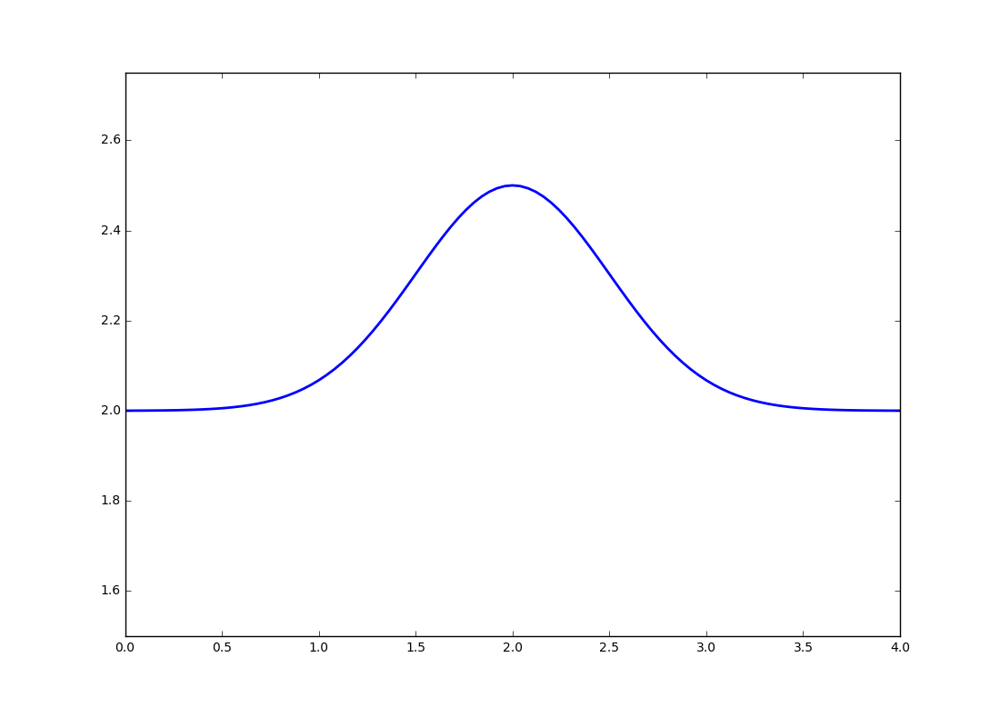
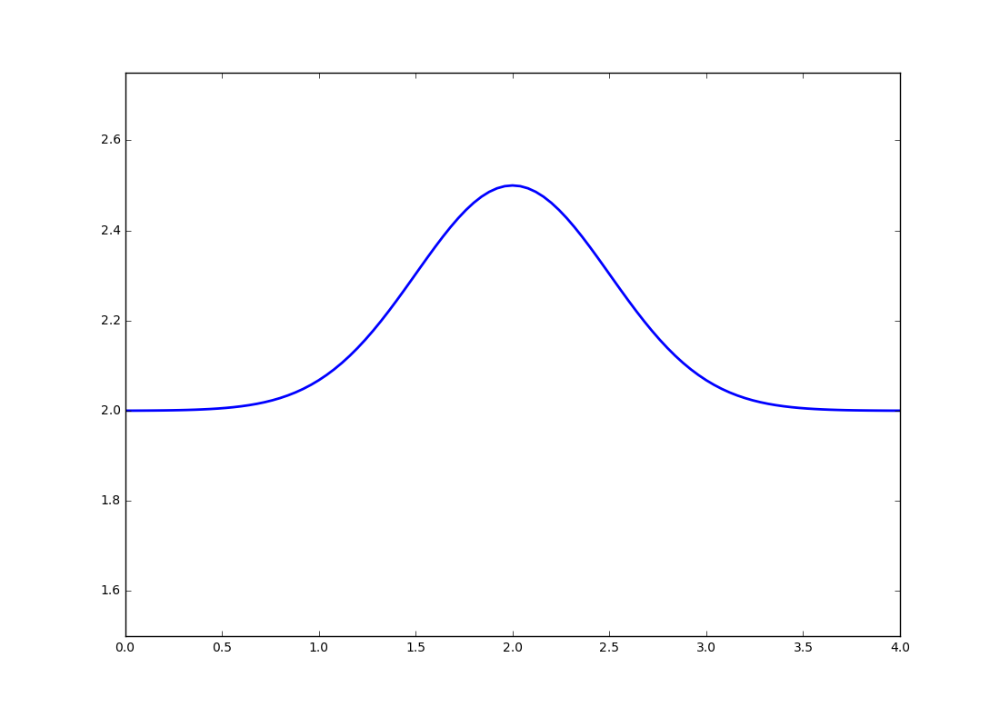
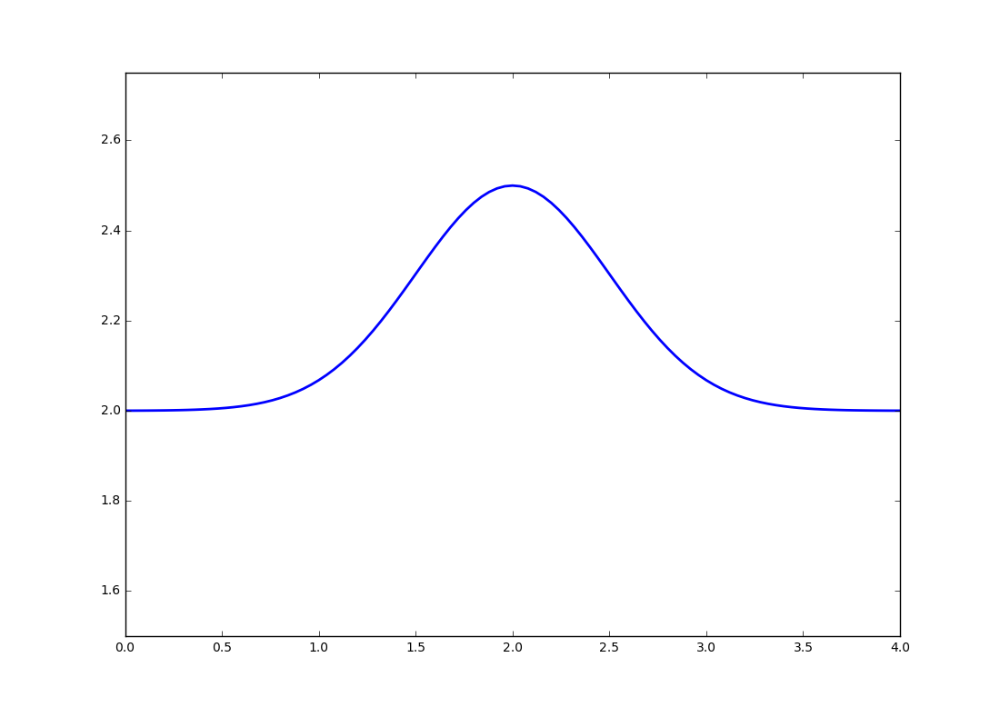
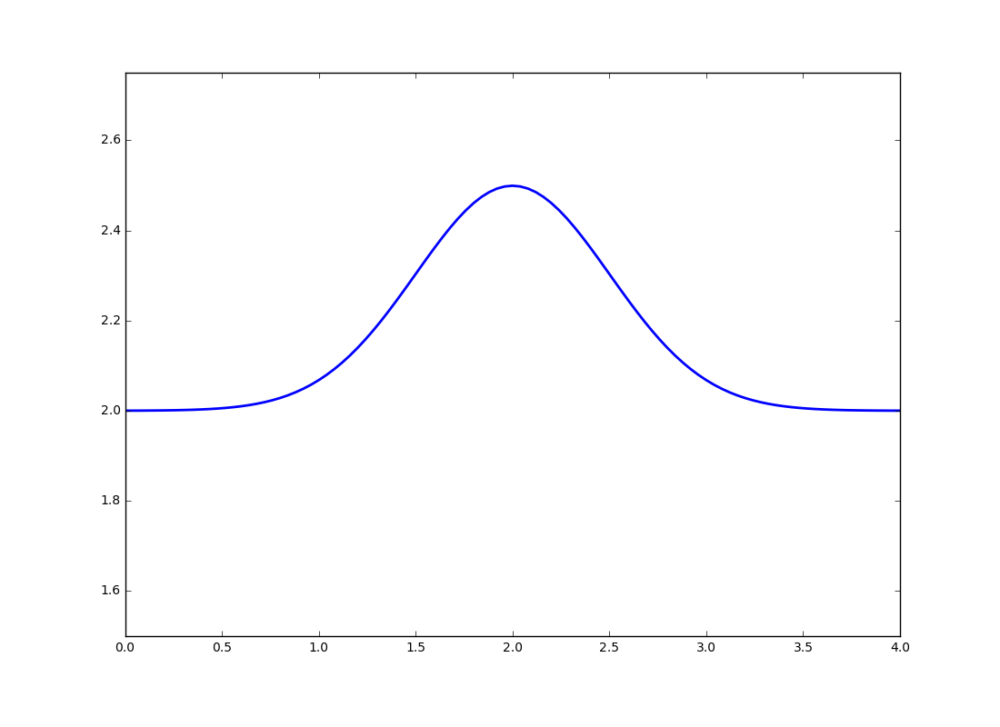
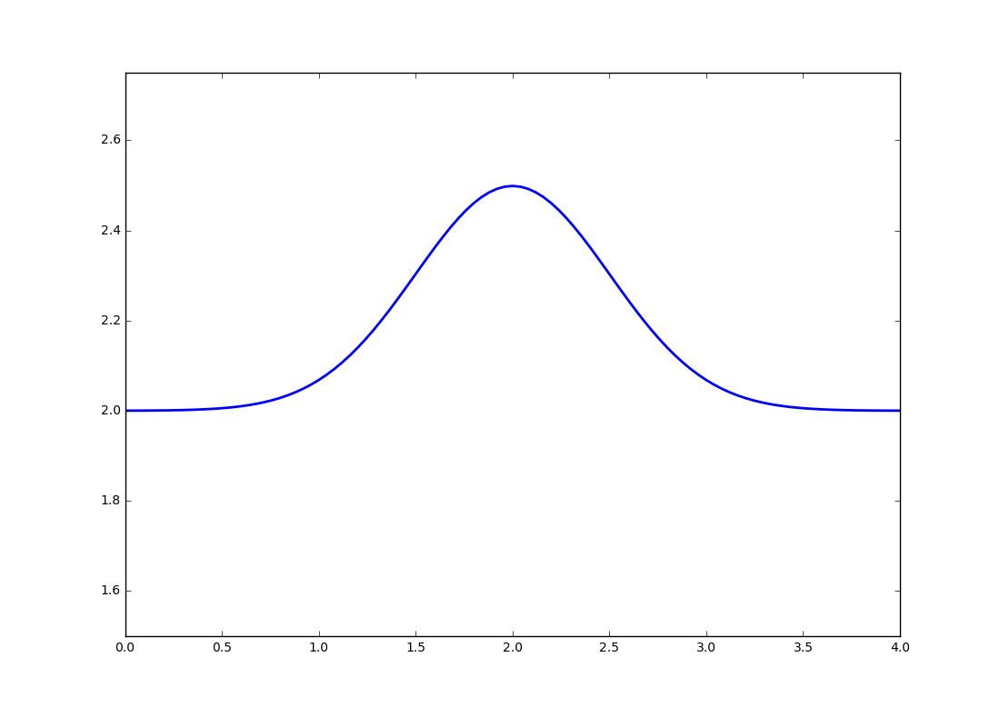
...
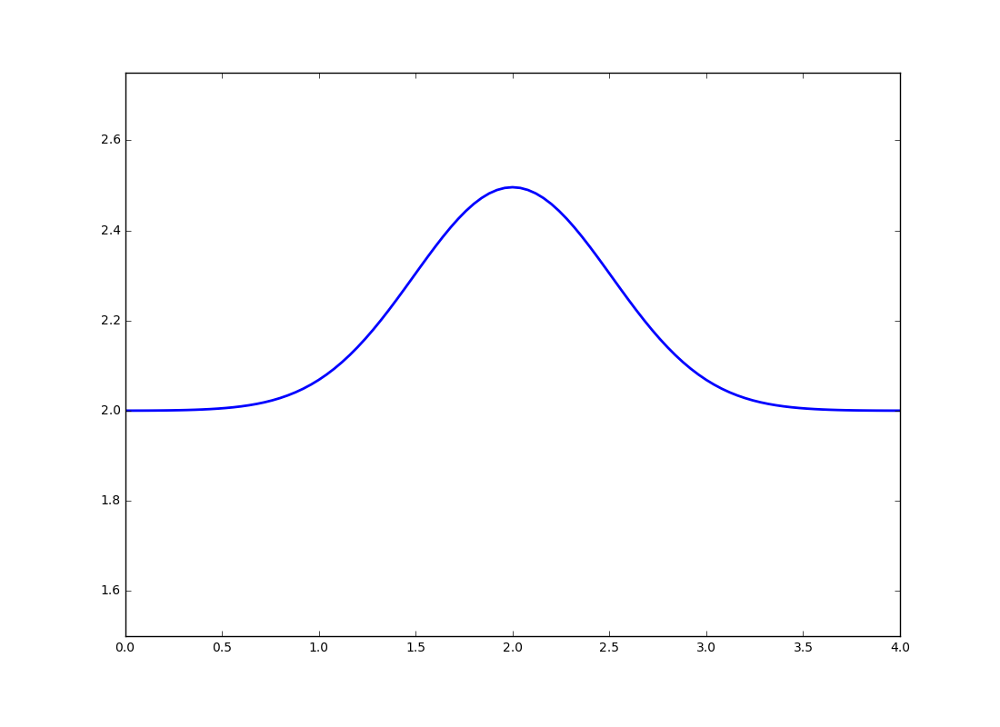
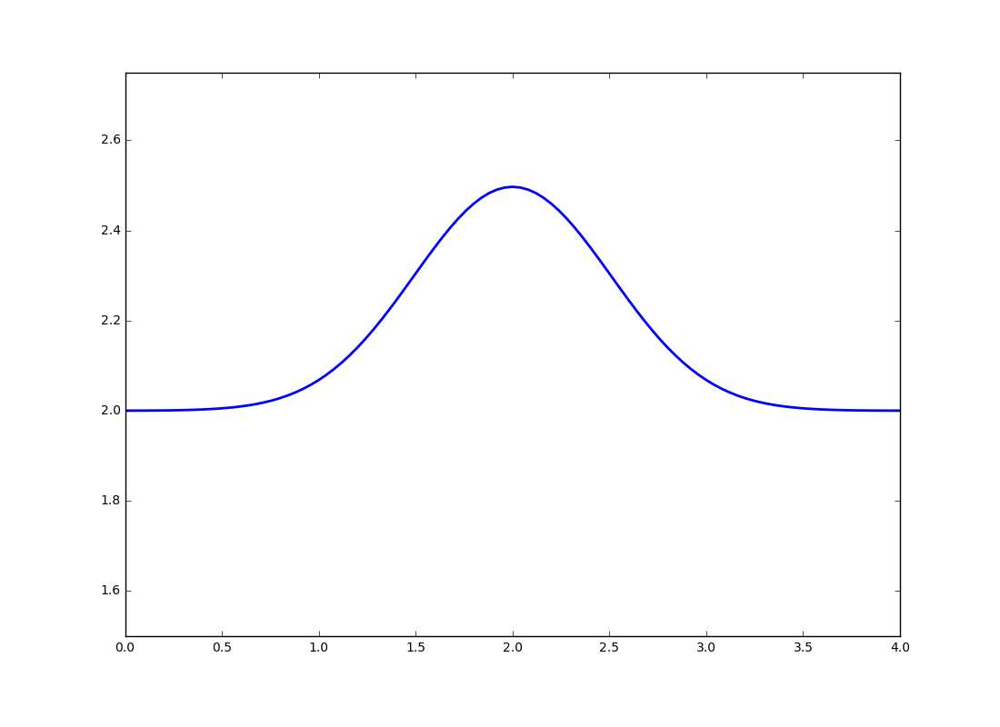
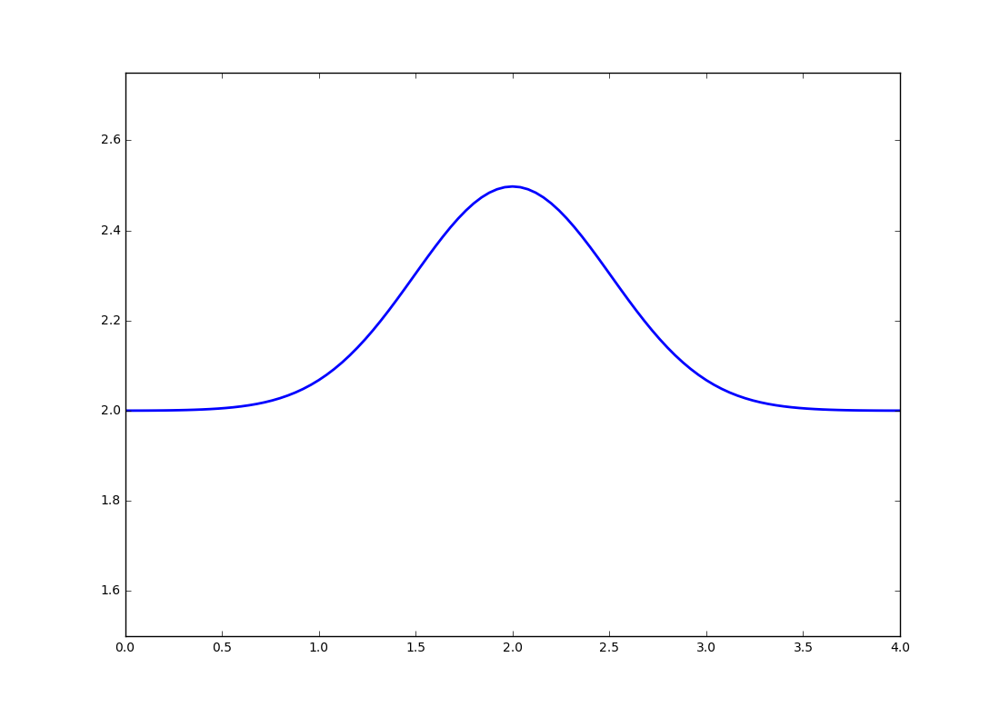
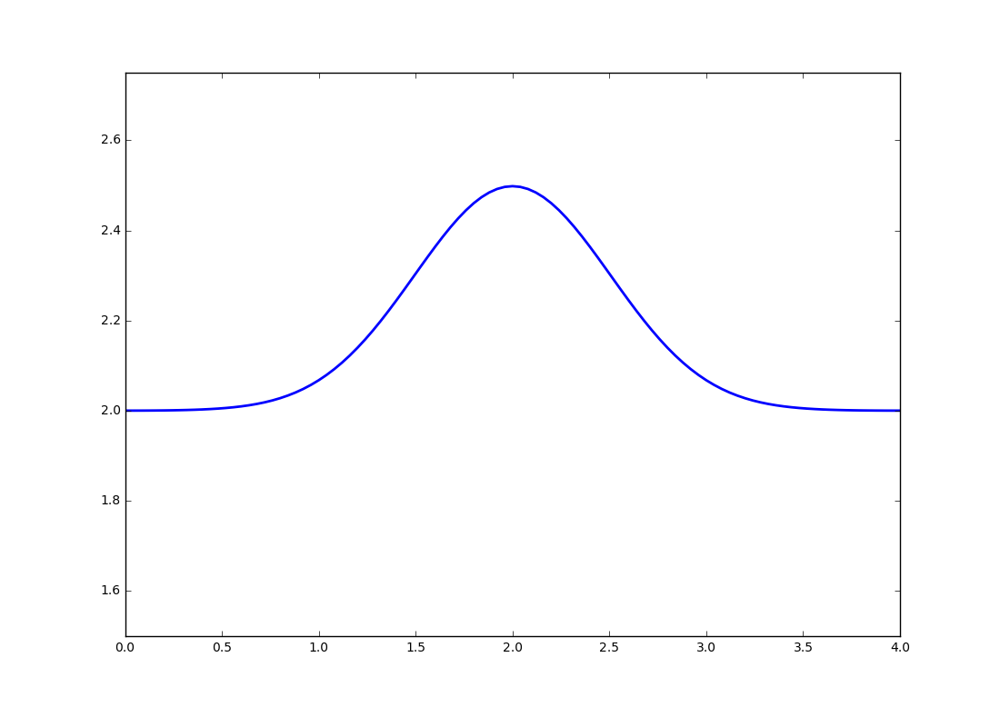
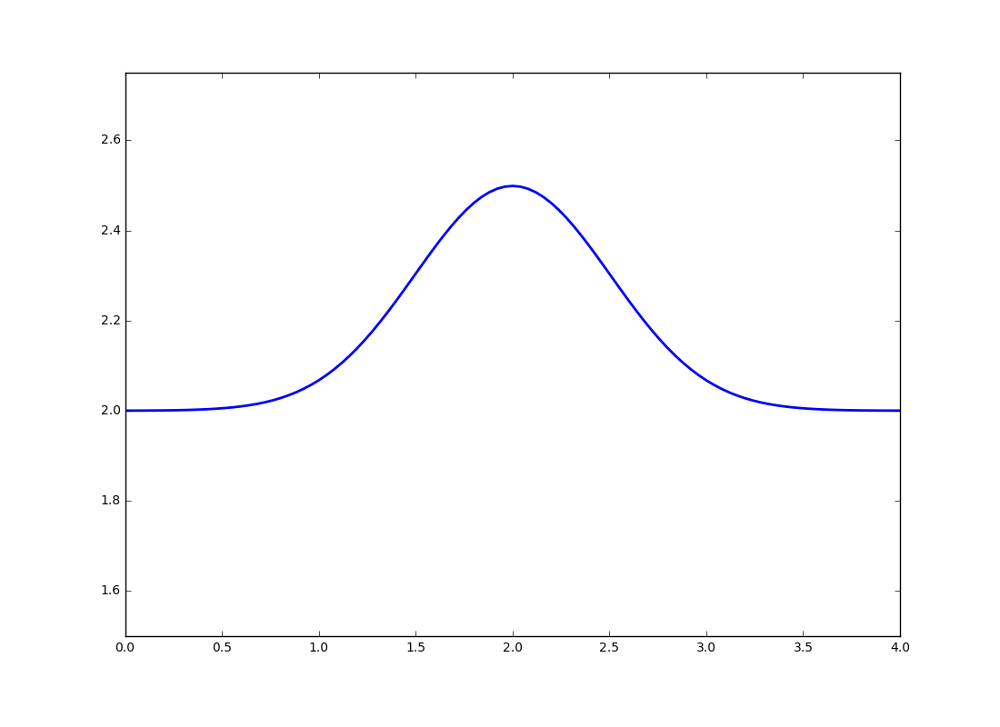

In [3]:
Hhat = SWE_base_parameters.Hhat
g    = SWE_base_parameters.g
nx   = SWE_base_parameters.nx
dx   = SWE_base_parameters.dx
dt   = SWE_base_parameters.dt
xlen = SWE_base_parameters.xlen
nt   = 100
IC=2
#Reflective boundary conditions
BC=2

x = np.linspace(0.,xlen,nx)
H,U = initialise(x,IC)
Ht = np.zeros([nx,nt])
Ht[:,0]=H
Ht=python_1d_shallow(nt, nx, Ht, H, U, g, xlen, BC)

fig = plt.figure(figsize=(11,8))
ax = plt.axes(xlim=(0,4), ylim=(1.5,2.75))
line, = ax.plot([], [], lw=2)
def init():
    line.set_data([],[])
    return line, 

def animate(i):
    line.set_data(x, Ht[:,i])
    return line,

animation.FuncAnimation(fig, animate, init_func=init, frames=nt, interval=10, blit=True)

##Visualizing results with the "dam" initial condition
and we'll look at nt frames (which corresponds to nt timesteps)


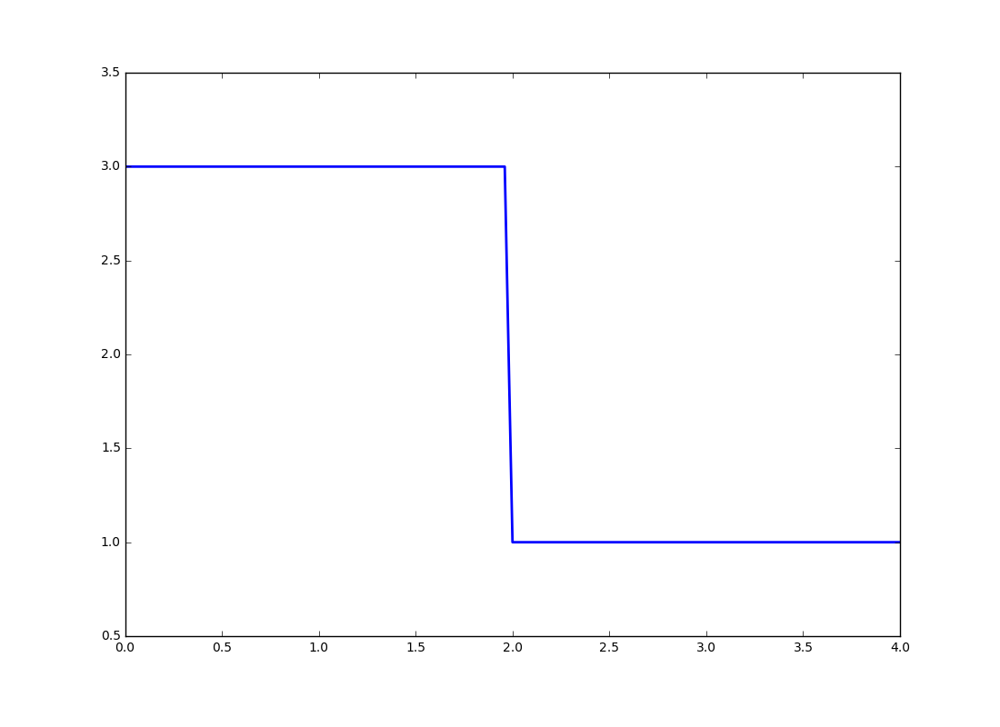
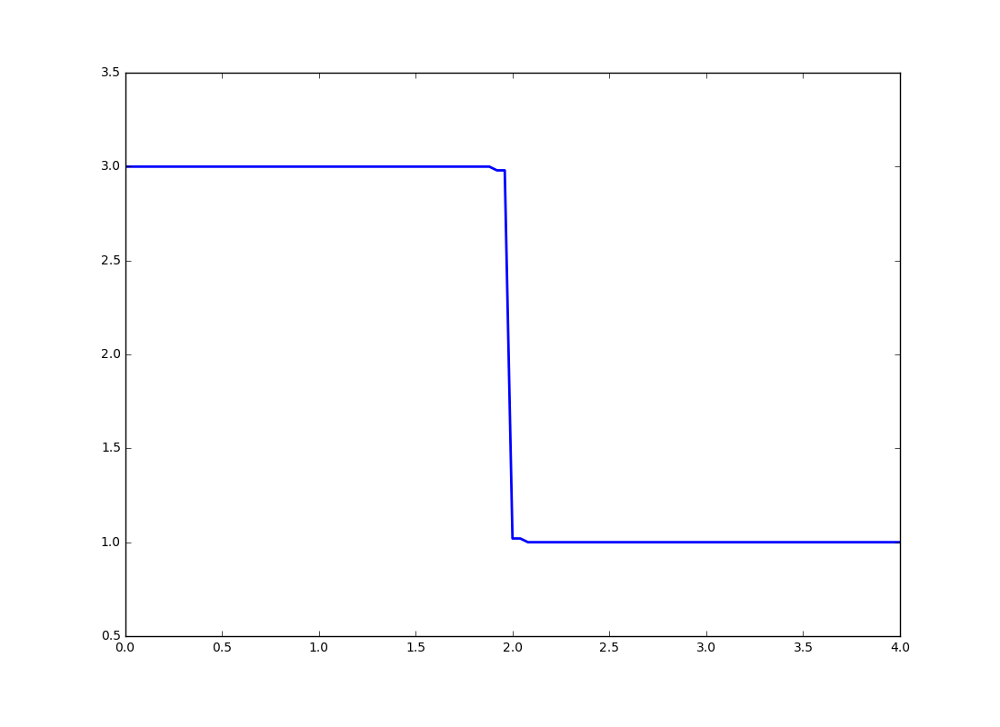
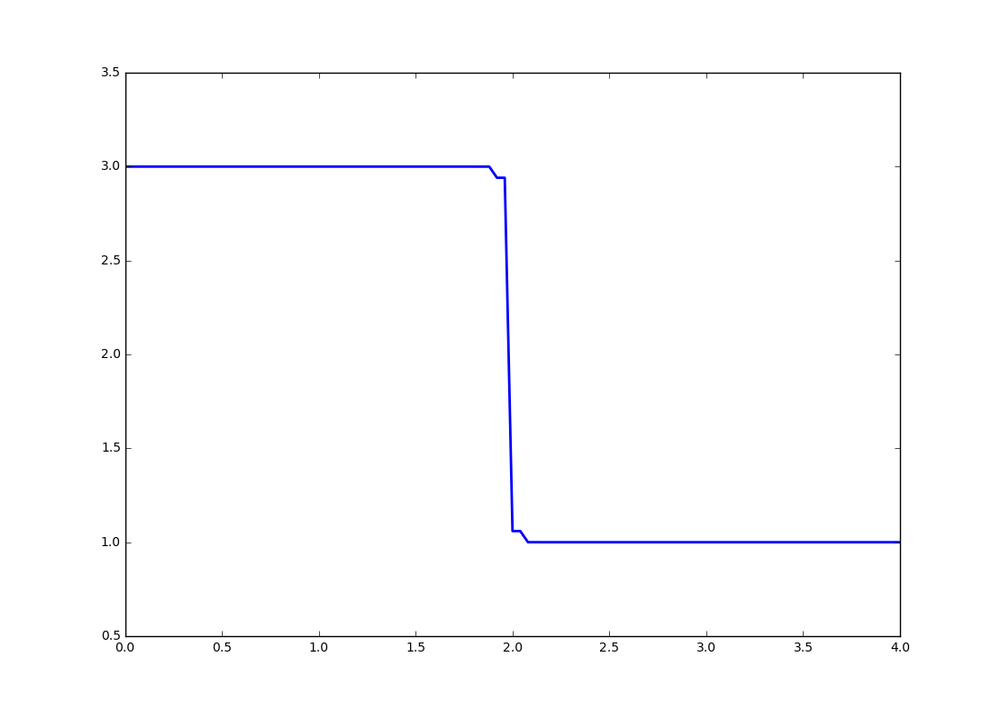
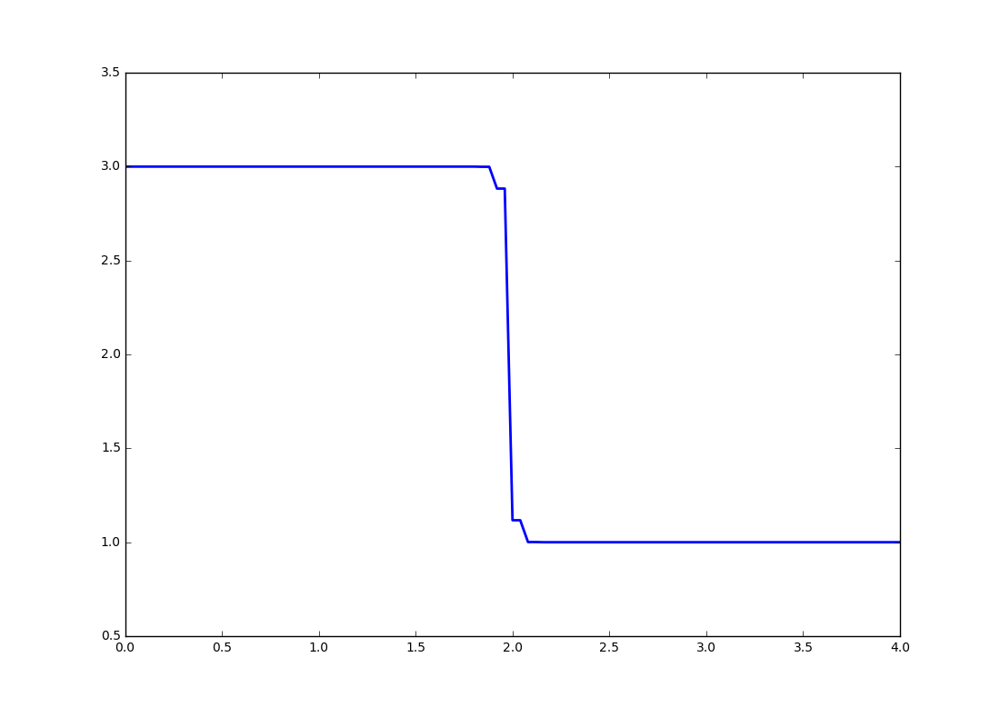
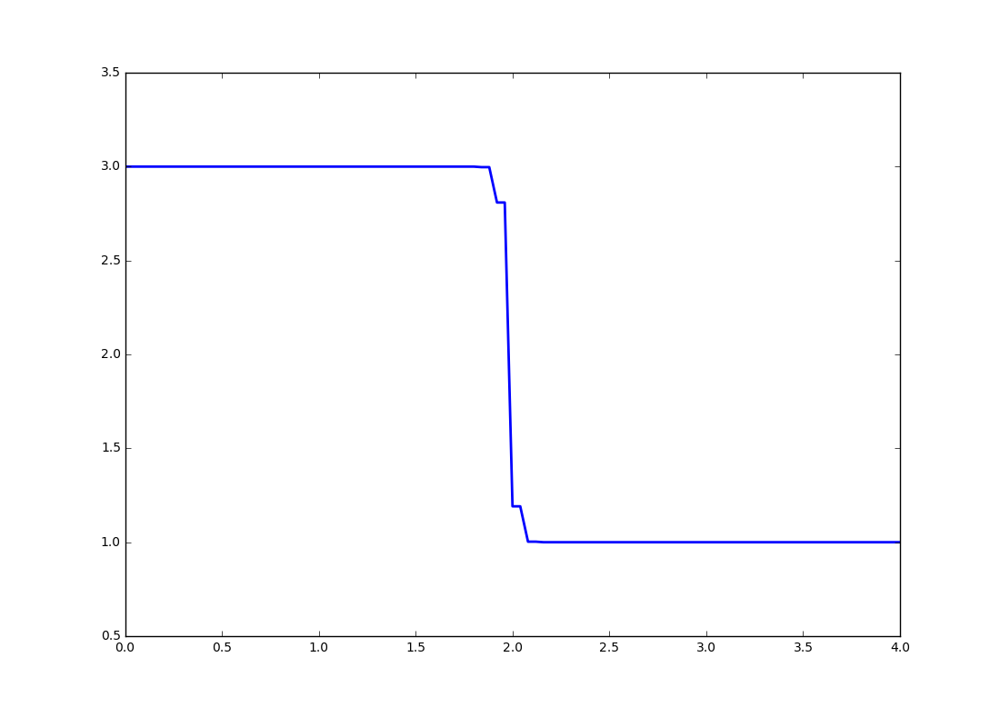
...
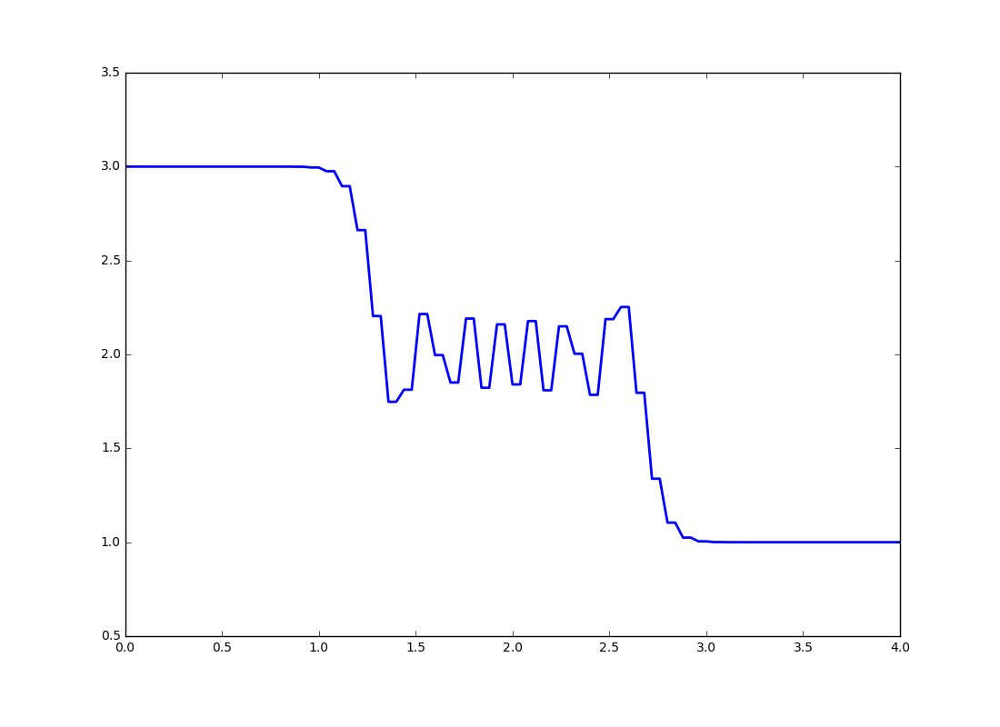
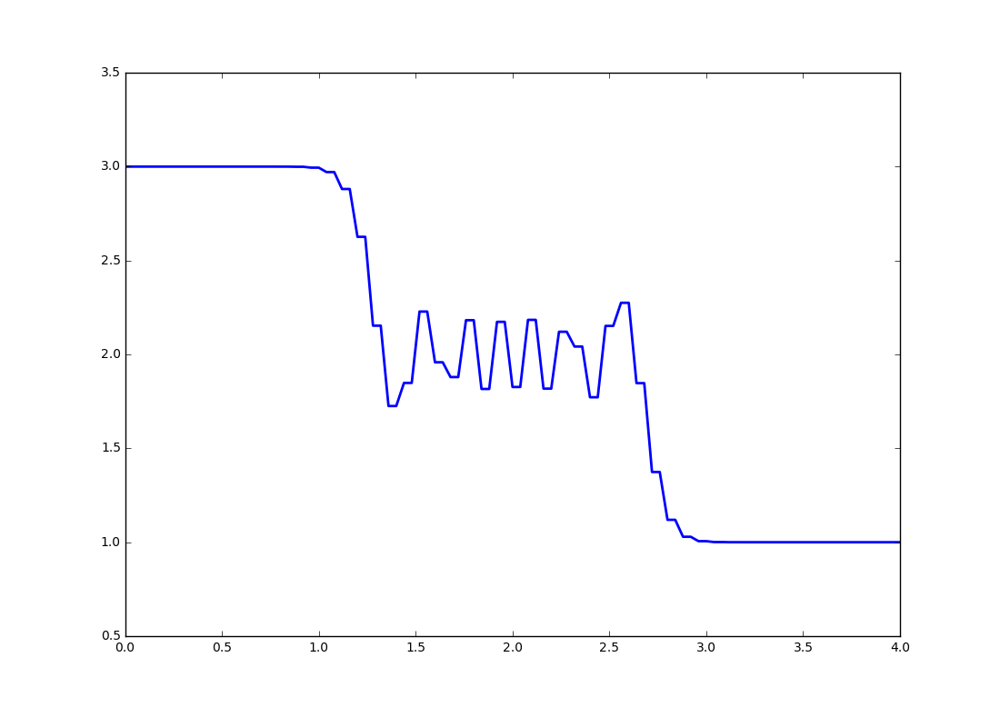
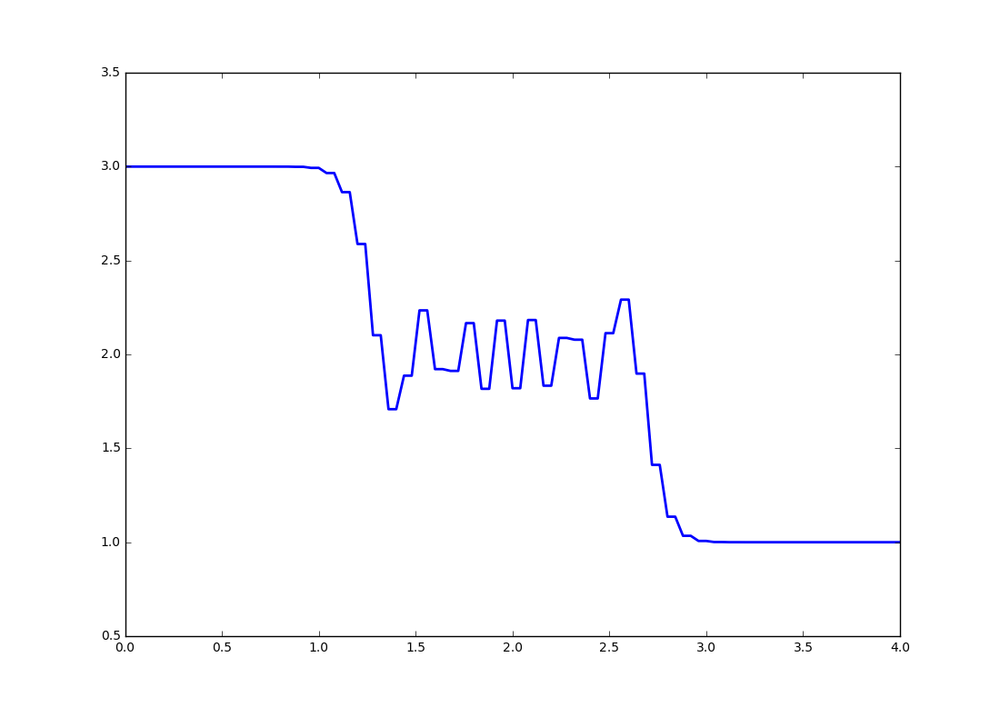
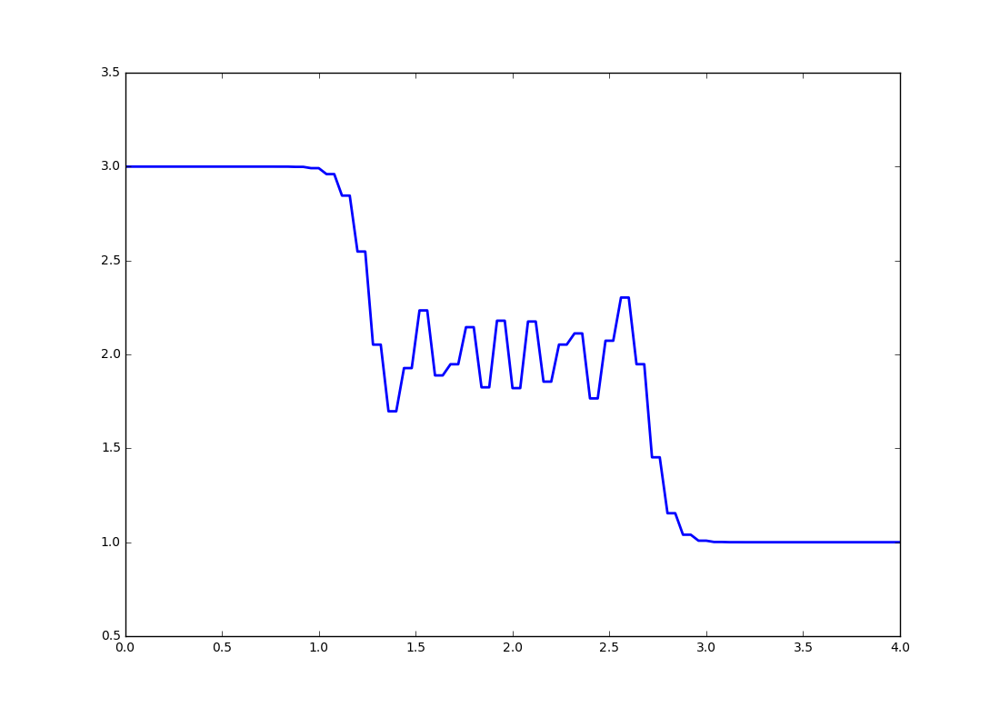
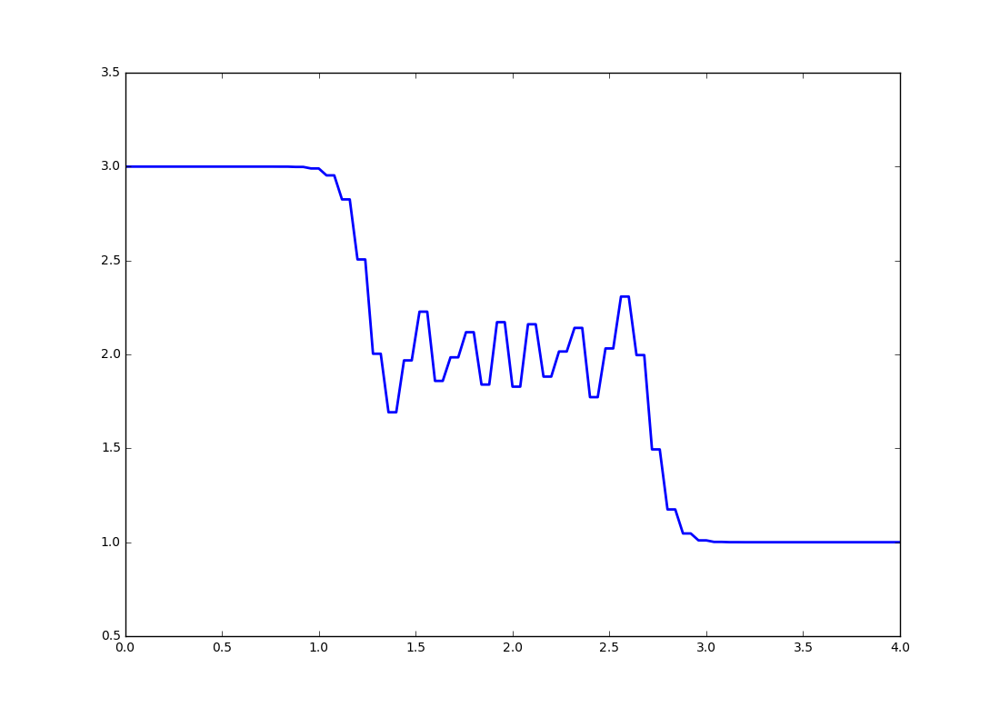

In [4]:
Hhat = SWE_base_parameters.Hhat
g    = SWE_base_parameters.g
nx   = SWE_base_parameters.nx
dx   = SWE_base_parameters.dx
dt   = SWE_base_parameters.dt
xlen = SWE_base_parameters.xlen
nt   = 100
IC=1
#Reflective boundary conditions
BC=2

x = np.linspace(0.,xlen,nx)
H,U = initialise(x,IC)
Ht = np.zeros([nx,nt])
Ht[:,0]=H
Ht=python_1d_shallow(nt, nx, Ht, H, U, g, xlen, BC)

fig = plt.figure(figsize=(11,8))
ax = plt.axes(xlim=(0,4), ylim=(0.5,3.5))
line, = ax.plot([], [], lw=2)
def init():
    line.set_data([],[])
    return line, 

def animate(i):
    line.set_data(x, Ht[:,i])
    return line,

animation.FuncAnimation(fig, animate, init_func=init, frames=nt, interval=10, blit=True)

# Next steps
A few more things could be done to improve the notebook

1\. move all the parameter setting to a file to be exec'ed

2\. write a d_dt function to do the time stepping (similar to what is in the current python file, shallowwater_base.py)

3\. move all the figure definitions etc. to a file to be exec'ed
